In [1]:
using PlotlyJS, Statistics, BenchmarkTools, DataFrames, JSON, StatsBase, Random, Distributions, KernelDensity, ProgressBars

## Creating & Validating the Attraction-Repulsion Model

In [2]:
mutable struct Agent
    id::Int16
    I::Float64
    E::Float64
    T::Float64
    R::Float64
    group::Char
end

function limit(val::Float64, method::String)

    if method == "trunc"
        if val > 1 return 1.
        elseif val < 0 return 0.
        end
    elseif val >= 1 || val <= 0
        temp::Float64 = 0.
        while temp >= 1 || temp <= 0
            temp = randn() / 5 + .5
        end
        return temp
    end

    return val
        
end

function interact(agent1::Agent, agent2::Agent, dist::Float64, affect_ad::Bool)
    
    if !affect_ad
        if abs(dist) <= agent1.T
            agent1.I = limit(agent1.I + agent1.R * dist, "trunc")
        else
            agent1.I = limit(agent1.I - agent1.R * dist, "trunc")
        end
    else
        direction = dist / abs(dist)
        if agent1.group == agent2.group
            agent1.I = limit(agent1.I + agent1.R * direction / 3, "trunc")
        else
            agent1.I = limit(agent1.I - agent1.R * direction * (1-agent1.T) / 1.5, "trunc")
        end
    end

end

function step(agents::Vector{Agent}, affect_ad::Bool, affect_h::Bool)
    
    agent1::Agent = rand(agents)
    agent2::Agent = Agent(0,0,0,0,0,'A')
    while true
        agent2 = rand(agents)
        if agent1.id != agent2.id
            break
        end
    end
    
    dist::Float64 = agent2.I - agent1.I
    if !affect_h
        prob = .5^(abs(dist) / agent1.E)
    else
        prob = agent1.group == agent2.group ? 1 - agent1.E : agent1.E
    end

    if rand(Float64) <= prob && dist != 0
        interact(agent1, agent2, dist, affect_ad)
    end

end

function runARM(cycles::Int64, agents::Vector{Agent}, affect_ad::Bool, affect_h::Bool)

    positions::Vector{Vector{Float64}} = []

    for s in 1:cycles
        for i in 1:length(agents)
            step(agents, affect_ad::Bool, affect_h::Bool)
        end
        push!(positions, [agent.I for agent in agents])
    end

    return positions

end

function constantSuite(trials::Int64,cycles::Int64, n_agents::Int64, E::Vector{Float64}, T::Vector{Float64}, R::Vector{Float64}, affect_ad::Bool, affect_h::Bool, summary::Bool)

    results::Vector{Any} = zeros(length(E) * length(T) * length(R))
    lk = ReentrantLock()
    
    
    for e in ProgressBar(eachindex(E))
        Threads.@threads for t in eachindex(T)
            for r in eachindex(R)
                res::Vector{Vector{Vector{Float64}}} = []
                for tr=1:trials
                    agents::Vector{Agent} = []
                    for i in 1:100
                        group = rand(['A','B'])
                        mean = group == 'B' ? .45 : .55
                        push!(agents, Agent(i, limit(randn() / 5 + mean, "norm"), E[e], T[t], R[r], group))
                    end
                    #agents = [Agent(i, limit(randn() / 5 + .5, "norm"), E[e], T[t], R[r], rand(['A','B'])) for i=1:n_agents]
                    push!(res, runARM(cycles, agents, affect_ad, affect_h))
                end
                if summary
                    summ = avgSeries(res)
                end
                lock(lk) do
                    index = (e - 1) * length(T) * length(R) + (t - 1) * length(R) + r
                    if summary
                        results[index] = [E[e], T[t], R[r], summ]
                    else
                        results[index] = [E[e], T[t], R[r], res]
                    end
                end
            end
        end
    end

    return results

end

function avgSeries(results::Vector{Vector{Vector{Float64}}})

    summation = zeros(length(results[1]))
    for series in results
        polarization = []
        for cycle in series
            push!(polarization, var(cycle))
        end
        summation = summation .+ polarization
    end
    return summation ./ length(results)
    
end

function getAvgResults(results)
    avg_res = []
    for res in results
        push!(avg_res, [res[1], res[2], res[3], avgSeries(res[4])])
    end
    return avg_res
end

function searchRes(res::Vector, E::Float64, T::Float64, R::Float64)

    paramMatch(row::Vector) = row[1] == E && row[2] == T && row[3] == R
    return filter(paramMatch, res)[1]

end

function compareSeries(series_list::Vector) 

    plot(
        map(x -> scatter(x=1:length(x[4]), y=x[4], name="$(x[1]), $(x[2]), $(x[3])"), series_list),
        Layout(width=600, height = 500)
    )

end

function agentDist(agents::Vector{Agent})

    plot(
        histogram(x=[a.I for a in agents], nbinsx=100),
        Layout(width=600, height=300)
    )

end

function compareHists(agents1::Vector{Agent}, label1::String, agents2::Vector{Agent}, label2::String, cycles::Vector{Int64}, affect_ad::Bool, affect_h::Bool) 

    p = make_subplots(
      rows=length(cycles), 
      cols=2, 
      shared_xaxes=true,
      shared_yaxes=true,
      column_titles=[label1, label2],
      row_titles=[ string("steps: ", c * 100) for c in cycles]
    )
  
    for i in eachindex(cycles)
  
      if i > 1
  
        runARM(cycles[i] - cycles[i-1], agents1, true, false)
        runARM(cycles[i] - cycles[i-1], agents2, true, true)
  
      end
      
      blue1 = [a.I for a in agents1 if a.group == 'B']
      red1 = [a.I for a in agents1 if a.group == 'A']
      add_trace!(p, histogram(x=blue1, nbinsx=50, marker_color="blue", opacity=0.4), row=i, col=1)
      add_trace!(p, histogram(x=red1, nbinsx=50, marker_color="red", opacity=0.4), row=i, col=1)

      blue2 = [a.I for a in agents2 if a.group == 'B']
      red2 = [a.I for a in agents2 if a.group == 'A']
      add_trace!(p, histogram(x=blue2, nbinsx=50, marker_color="blue", opacity=0.4), row=i, col=2)
      add_trace!(p, histogram(x=red2, nbinsx=50, marker_color="red", opacity=0.4), row=i, col=2)
  
    end
  
    relayout!(
      p, 
      #title_text="Comparing $(label1) to $(label2)", 
      showlegend=false, 
      width=500, 
      height=200*length(cycles),
      barmode="overlay"
    )

    return p
    
  end

  function paramMap(results::Vector{Any}, E::Float64, T::Float64, R::Float64, range1::Vector{Float64}, range2::Vector{Float64}, inorder::Bool)

    heat_dat = Array{Float64, 2}(undef, 0, length(range2))
    for i in range2
        row::Vector{Float64} = []
        for j in range1
            print()
            if inorder
                if E >= 0 p = searchRes(results, E, i, j)[4][10000]
                elseif T >= 0 p = searchRes(results, i, T, j)[4][10000]
                else p = searchRes(results, i, j, R)[4][10000]
                end
            else
                if E >= 0 p = searchRes(results, E, j, i)[4][10000]
                elseif T >= 0 p = searchRes(results, j, T, i)[4][10000]
                else p = searchRes(results, j, i, R)[4][10000]
                end
            end
            push!(row, p)
        end
        heat_dat = vcat(heat_dat, reshape(row, 1, length(row)))
    end

    # return plot(
    #     heatmap(z=heat_dat),
    #     Layout(height = 500, width=550)
    # )

    return heatmap(z=heat_dat, x=range1, y=range2, zmin=0, zmax=.25)
end

paramMap (generic function with 1 method)

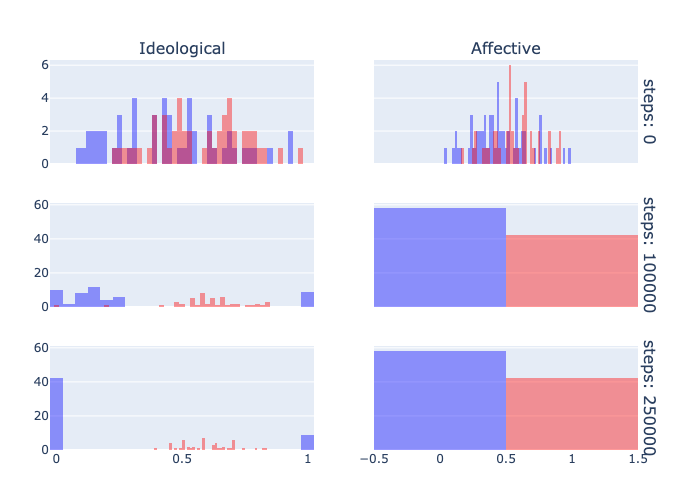

In [3]:
agents1::Vector{Agent} = []
for i in 1:100
    group = rand(['A','B'])
    mean = group == 'B' ? .45 : .55
    push!(agents1, Agent(i, limit(randn() / 5 + mean, "norm"), .1, .25, .25, group))
end

agents2::Vector{Agent} = []
for i in 1:100
    group = rand(['A','B'])
    mean = group == 'B' ? .45 : .55
    push!(agents2, Agent(i, limit(randn() / 5 + mean, "norm"), .3, .25, .25, group))
end

compareHists(agents1, "Ideological", agents2, "Affective", [0, 1000, 2500], true, true)

In [4]:
open("base_res.json", "r") do f
    global id_results = JSON.parse(f)
end;

open("h_affect_results.json", "r") do f
    global af_results = JSON.parse(f)
end;

## Comparing Tolerance

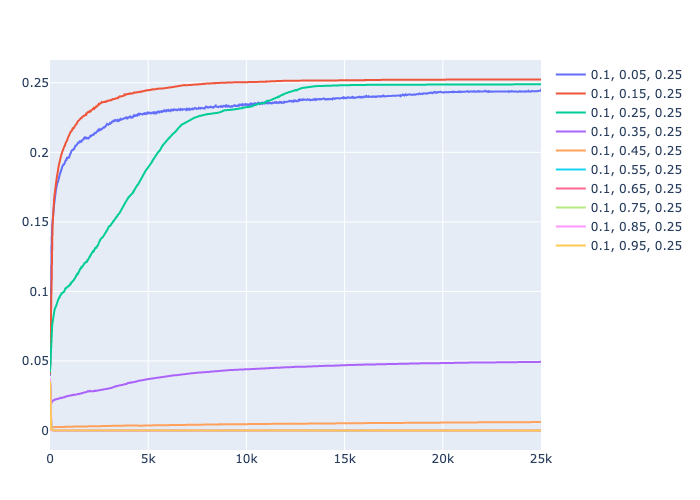

In [5]:
series_list = [
    searchRes(id_results, .1, .05, .25), 
    searchRes(id_results, .1, .15, .25), 
    searchRes(id_results, .1, .25, .25),
    searchRes(id_results, .1, .35, .25), 
    searchRes(id_results, .1, .45, .25), 
    searchRes(id_results, .1, .55, .25),
    searchRes(id_results, .1, .65, .25),
    searchRes(id_results, .1, .75, .25),
    searchRes(id_results, .1, .85, .25),
    searchRes(id_results, .1, .95, .25)
]
compareSeries(series_list)

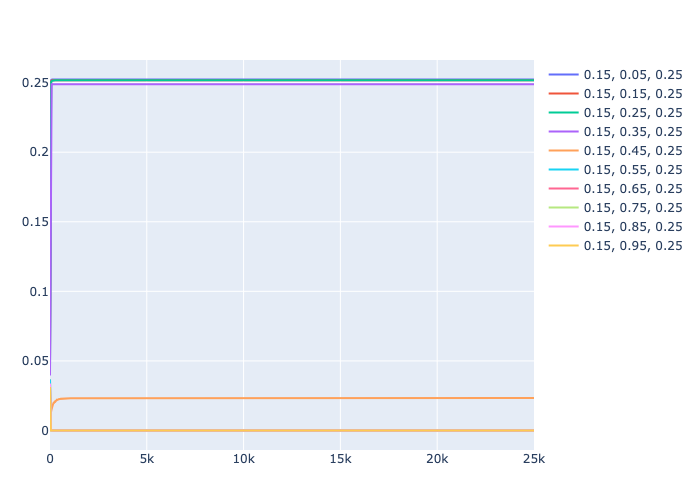

In [6]:
series_list = [
    searchRes(af_results, .15, .05, .25), 
    searchRes(af_results, .15, .15, .25), 
    searchRes(af_results, .15, .25, .25),
    searchRes(af_results, .15, .35, .25), 
    searchRes(af_results, .15, .45, .25), 
    searchRes(af_results, .15, .55, .25),
    searchRes(af_results, .15, .65, .25),
    searchRes(af_results, .15, .75, .25),
    searchRes(af_results, .15, .85, .25),
    searchRes(af_results, .15, .95, .25)
]
compareSeries(series_list)

## Visualize Polarization

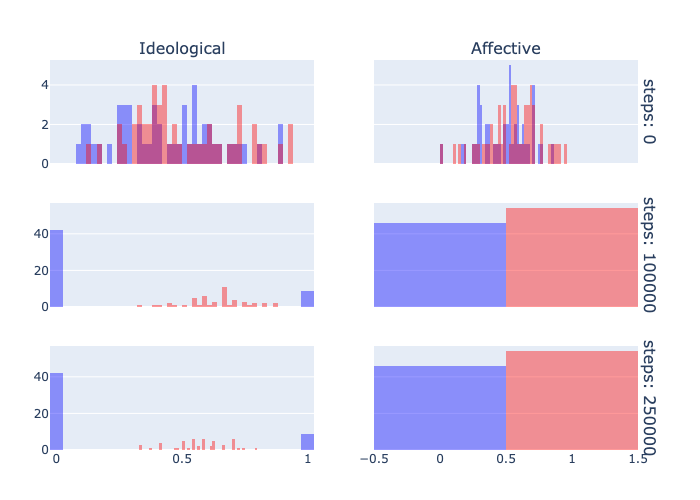

In [7]:
agents1::Vector{Agent} = []
for i in 1:100
    group = rand(['A','B'])
    mean = group == 'B' ? .45 : .55
    push!(agents1, Agent(i, limit(randn() / 5 + mean, "norm"), .1, .25, .25, group))
end

agents2::Vector{Agent} = []
for i in 1:100
    group = rand(['A','B'])
    mean = group == 'B' ? .45 : .55
    push!(agents2, Agent(i, limit(randn() / 5 + mean, "norm"), .1, .25, .25, group))
end


compareHists(agents1, "Ideological", agents2, "Affective", [0, 1000, 2500], true, true)

## Exposure by Response for T=.25,.45,.75

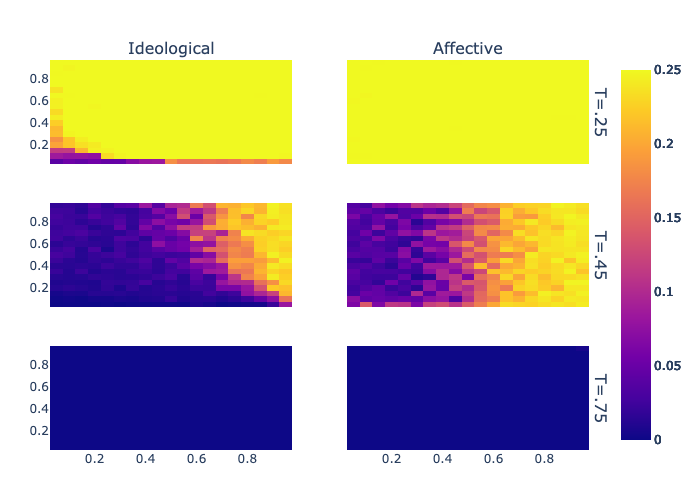

In [8]:
p = make_subplots(
      rows=3, 
      cols=2, 
      shared_xaxes=true,
      shared_yaxes=true,
      column_titles=["Ideological", "Affective"],
      row_titles=["T=.25", "T=.45", "T=.75"]
    )



add_trace!(p, paramMap(id_results, -1., .25, -1., [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=1, col=1)
add_trace!(p, paramMap(af_results, -1., .25, -1., [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=1, col=2)

add_trace!(p, paramMap(id_results, -1., .45, -1., [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=2, col=1)
add_trace!(p, paramMap(af_results, -1., .45, -1., [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=2, col=2)

add_trace!(p, paramMap(id_results, -1., .75, -1., [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=3, col=1)
add_trace!(p, paramMap(af_results, -1., .75, -1., [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=3, col=2)


relayout!(
      p, 
      showlegend=true, 
      width=500, 
      height=700,
      barmode="overlay",
      xaxis_titles="steps"
    )

p

## Simulations

In [9]:
function simulate(N::Int64, n_agents::Int64, cycles::Int64, affect_ad::Bool, affect_h::Bool, locked::Vector{Float64}=[-1., -1., -1.])
    
    results::Vector{Any} = zeros(N)
    lk = ReentrantLock()

    Threads.@threads for thread=1:N
        E = locked[1] == -1. ? rand(Beta(1,1)) : locked[1] 
        T = locked[2] == -1. ? rand(Beta(1,1)) : locked[2] 
        R = locked[3] == -1. ? rand(Beta(1,1)) : locked[3] 
        agents = [Agent(i, limit(randn() / 5 + .5, "norm"), E, T, R, rand(['A','B'])) for i=1:n_agents]
        res = [runARM(cycles, agents, affect_ad, affect_h)]
        lock(lk) do
            results[thread] = [E, T, R, res]
        end
    end

    return results

end 

simulate (generic function with 2 methods)

### Comparing Parameters for Random Simulations

In [24]:
sims = simulate(1000, 100, 2500, true, false, [-1., -1., -1.])
id_sims = getAvgResults(sims);

sims = simulate(1000, 100, 2500, true, true, [-1., -1., -1.])
af_sims = getAvgResults(sims);

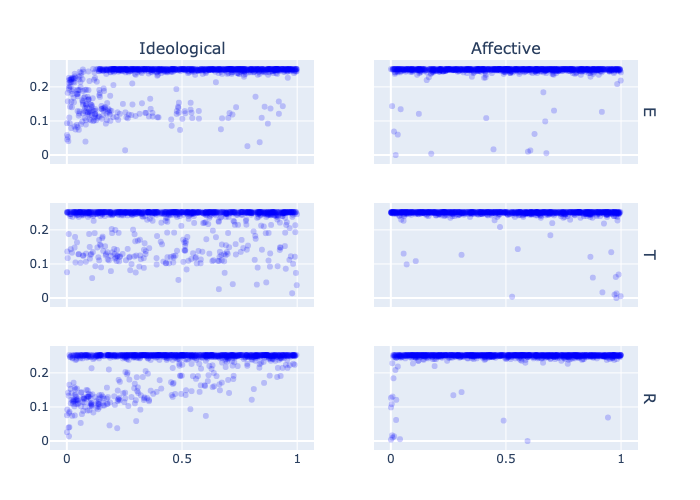

In [25]:
p = make_subplots(
      rows=3, 
      cols=2, 
      shared_xaxes=true,
      shared_yaxes=true,
      column_titles=["Ideological", "Affective"],
      row_titles=["E", "T", "R"]
    )

add_trace!(p, scatter(x=[s[1] for s in id_sims], y=[s[4][2500] for s in id_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=1, col=1)
add_trace!(p, scatter(x=[s[1] for s in af_sims], y=[s[4][2500] for s in af_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=1, col=2)

add_trace!(p, scatter(x=[s[2] for s in id_sims], y=[s[4][2500] for s in id_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=2, col=1)
add_trace!(p, scatter(x=[s[2] for s in af_sims], y=[s[4][2500] for s in af_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=2, col=2)

add_trace!(p, scatter(x=[s[3] for s in id_sims], y=[s[4][2500] for s in id_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=3, col=1)
add_trace!(p, scatter(x=[s[3] for s in af_sims], y=[s[4][2500] for s in af_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=3, col=2)

relayout!(
      p, 
      showlegend=false, 
      width=500, 
      height=800,
      barmode="overlay",
      xaxis_titles="steps"
    )

p

### Simulation Based Inference

In [26]:
id_truth = getAvgResults(simulate(1, 100, 2500, false, true, [.05, .25, .25]))
af_truth = getAvgResults(simulate(1, 100, 2500, false, true, [.05, .25, .25]));

In [27]:
function distance(sample, truth)
    return sum((sample[1][4] - truth[1][4]).^2)
end

function plot_posterior(posterior::Vector{Float64}, truth::Float64)
    p = plot(histogram(x=posterior, nbinsx=100, range_x=[0,1]), Layout(xaxis_range=[0, 1], width=500))
    
    add_shape!(p, line(
        x0=mean(posterior), y0=0,
        x1=mean(posterior), y1=length(posterior),
        line=attr(color="Red", width=3),
    ))

    add_shape!(p, line(
        x0=truth, y0=0,
        x1=truth, y1=length(posterior),
        line=attr(color="Green", width=3),
    ))

    return p
end

function abc(truth::Vector{Any}, n_samples::Int64, threshold::Float64, affect_ad::Bool, locked::Vector{Float64})
    
    posterior::Vector{Float64} = []
    for i in 1:n_samples
        dist = threshold + 1
        theta = 0
        while dist > threshold
            theta = rand(Beta(1,1))
            sample = getAvgResults(simulate(1, 100, 2500, affect_ad, [theta, .25, .25]))
            dist = distance(truth, sample)
        end
        push!(posterior, theta)
    end
    return posterior
end

# https://link.springer.com/article/10.1007/s11222-011-9296-2
function metropolis_hastings(truth::Vector{Any}, n_samples::Int64, n_iters::Int64, affect_ad::Bool, locked::Vector{Float64})

    thetas::Vector{Float64} = []
    distances::Vector{Float64} = []
    ctr = 0

    for i in 1:n_samples

        theta = rand(Beta(1,1))
        sample = getAvgResults(simulate(1, 100, 2500, affect_ad, [theta, .25, .25]))
        dist = distance(truth, sample)
        
        push!(thetas, theta)
        push!(distances, dist)

    end

    theta_sets = [thetas]

    for i in 1:n_iters

        old_kde = kde(thetas, boundary=(0,1), bandwidth=.1)

        z = sample(old_kde.x, Weights(old_kde.density))
        z_sample = getAvgResults(simulate(1, 100, 2500, affect_ad, [z, .25, .25]))
        z_dist = distance(truth, z_sample)

        n_index = rand(1:length(thetas))
        n = thetas[n_index]

        prop_thetas = copy(thetas)
        prop_thetas[n_index] = z
        prop_kde = kde(prop_thetas, boundary=(0,1), bandwidth=.1)

        z_kde = pdf(old_kde, z)
        n_kde = pdf(prop_kde, n)

        proxy_dist = (1 ./ distances) / sum(1 ./ distances)

        prop_distances = copy(distances)
        prop_distances[n_index] = z_dist
        prop_proxy_dist = (1 ./ prop_distances) / sum(1 ./ prop_distances)

        switch_prob = (prop_proxy_dist[n_index] * n_kde) / (proxy_dist[n_index] * z_kde)
        # switch_prob = prop_proxy_dist[n_index] / proxy_dist[n_index]

        if rand(Beta(1,1)) < min(1, switch_prob)
            ctr = ctr + 1
            thetas = prop_thetas
            distances = prop_distances
        end

        push!(theta_sets, thetas)

    end

    posterior = theta_sets[1]
    for i in 2:length(theta_sets)
        posterior = posterior .+ theta_sets[i]
    end

    return thetas
end


metropolis_hastings (generic function with 1 method)

In [28]:
posterior = abc(id_truth, 10, .5, false, [-1., .25, .25])
plot_posterior(posterior, .05)

MethodError: MethodError: no method matching simulate(::Int64, ::Int64, ::Int64, ::Bool, ::Vector{Float64})
Closest candidates are:
  simulate(::Int64, ::Int64, ::Int64, ::Bool, !Matched::Bool) at ~/Documents/Coding/VSCode/ARM-2D/julia/ARM-develop.ipynb:1
  simulate(::Int64, ::Int64, ::Int64, ::Bool, !Matched::Bool, !Matched::Vector{Float64}) at ~/Documents/Coding/VSCode/ARM-2D/julia/ARM-develop.ipynb:1

In [29]:
posterior = abc(af_truth, 10, .5, true, [-1., .25, .25])
plot_posterior(posterior, .05)

MethodError: MethodError: no method matching simulate(::Int64, ::Int64, ::Int64, ::Bool, ::Vector{Float64})
Closest candidates are:
  simulate(::Int64, ::Int64, ::Int64, ::Bool, !Matched::Bool) at ~/Documents/Coding/VSCode/ARM-2D/julia/ARM-develop.ipynb:1
  simulate(::Int64, ::Int64, ::Int64, ::Bool, !Matched::Bool, !Matched::Vector{Float64}) at ~/Documents/Coding/VSCode/ARM-2D/julia/ARM-develop.ipynb:1

In [30]:
posterior = metropolis_hastings(id_truth, 25, 1000, false, [-1., .25, .25])
plot_posterior(posterior, .05)

MethodError: MethodError: no method matching simulate(::Int64, ::Int64, ::Int64, ::Bool, ::Vector{Float64})
Closest candidates are:
  simulate(::Int64, ::Int64, ::Int64, ::Bool, !Matched::Bool) at ~/Documents/Coding/VSCode/ARM-2D/julia/ARM-develop.ipynb:1
  simulate(::Int64, ::Int64, ::Int64, ::Bool, !Matched::Bool, !Matched::Vector{Float64}) at ~/Documents/Coding/VSCode/ARM-2D/julia/ARM-develop.ipynb:1

In [31]:
posterior = metropolis_hastings(af_truth, 25, 1000, true, [-1., .25, .25])
plot_posterior(posterior, .05)

MethodError: MethodError: no method matching simulate(::Int64, ::Int64, ::Int64, ::Bool, ::Vector{Float64})
Closest candidates are:
  simulate(::Int64, ::Int64, ::Int64, ::Bool, !Matched::Bool) at ~/Documents/Coding/VSCode/ARM-2D/julia/ARM-develop.ipynb:1
  simulate(::Int64, ::Int64, ::Int64, ::Bool, !Matched::Bool, !Matched::Vector{Float64}) at ~/Documents/Coding/VSCode/ARM-2D/julia/ARM-develop.ipynb:1